<h1 style="text-align:center; color:black;">Regression</h1>

## Work Overview

This notebook covers the following topics:

- Importing Libraries and Loading Data
- Data Overview
- Univariate Analysis
- Bi-variate Analysis
- Data Cleaning
- Feture Selection
- Model Training and Evaluation

### Importing Libraries and Loading Data

In [75]:
import numpy as np 
import pandas as pd 
import missingno as msno
import plotly.express as px
import plotly.graph_objs as go
import seaborn as sns
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [10]:
california = fetch_california_housing()
data = pd.DataFrame(california.data, columns=california.feature_names)
data['MEDV'] = california.target
data.head()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MEDV
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422


### Data Overview

In [11]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20640 entries, 0 to 20639
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   MedInc      20640 non-null  float64
 1   HouseAge    20640 non-null  float64
 2   AveRooms    20640 non-null  float64
 3   AveBedrms   20640 non-null  float64
 4   Population  20640 non-null  float64
 5   AveOccup    20640 non-null  float64
 6   Latitude    20640 non-null  float64
 7   Longitude   20640 non-null  float64
 8   MEDV        20640 non-null  float64
dtypes: float64(9)
memory usage: 1.4 MB


In [12]:
print("Column names:", data.columns.tolist())

Column names: ['MedInc', 'HouseAge', 'AveRooms', 'AveBedrms', 'Population', 'AveOccup', 'Latitude', 'Longitude', 'MEDV']


#### Columns Description

The `fetch_california_housing` dataset contains the following columns:

| **Column Name** | **Description**                                                                                      |
|-----------------|------------------------------------------------------------------------------------------------------|
| `MedInc`        | Median income in block group (in tens of thousands of dollars).                                       |
| `HouseAge`      | Median age of houses in block group.                                                                  |
| `AveRooms`      | Average number of rooms per household in block group.                                                 |
| `AveBedrms`     | Average number of bedrooms per household in block group.                                              |
| `Population`    | Total population in block group.                                                                      |
| `AveOccup`      | Average number of household members in block group.                                                   |
| `Latitude`      | Latitude of block group centroid.                                                                     |
| `Longitude`     | Longitude of block group centroid.                                                                    |
| `MEDV`          | Median house value in block group (in hundreds of thousands of dollars).                              |

In [14]:
# The shape of the dataset
print(f"The dataset contains {data.shape[0]} rows and {data.shape[1]} columns.")

The dataset contains 20640 rows and 9 columns.


In [15]:
# Statistical measurements
data.describe()

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MEDV
count,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000,20640.000000
mean,3.870671,28.639486,5.429000,1.096675,1425.476744,3.070655,35.631861,-119.569704,2.068558
std,1.899822,12.585558,2.474173,0.473911,1132.462122,10.386050,2.135952,2.003532,1.153956
min,0.499900,1.000000,0.846154,0.333333,3.000000,0.692308,32.540000,-124.350000,0.149990
25%,2.563400,18.000000,4.440716,1.006079,787.000000,2.429741,33.930000,-121.800000,1.196000
50%,3.534800,29.000000,5.229129,1.048780,1166.000000,2.818116,34.260000,-118.490000,1.797000
75%,4.743250,37.000000,6.052381,1.099526,1725.000000,3.282261,37.710000,-118.010000,2.647250
max,15.000100,52.000000,141.909091,34.066667,35682.000000,1243.333333,41.950000,-114.310000,5.000010


In [16]:
# Checking dublicated rows
data.duplicated().sum()

0

<div style="background-color: #e6f7ff; padding: 10px; border-radius: 3px; box-shadow: 0 2px 4px rgba(0,0,0,0.1);">
    <strong style="color: #007bff;">Note:</strong> There are no duplicated rows.
</div>

<Axes: >

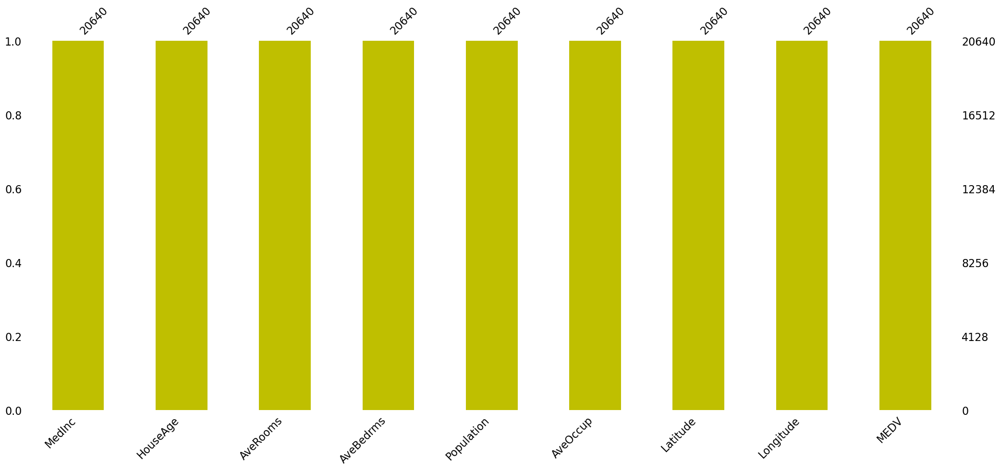

In [18]:
# Checking null values
msno.bar(data,color='y')

<div style="background-color: #e6f7ff; padding: 10px; border-radius: 3px; box-shadow: 0 2px 4px rgba(0,0,0,0.1);">
    <strong style="color: #007bff;">Note:</strong> There are no Null values.
</div>

### Univariate Analysis

In [20]:
# Function to visualize the distribution of each column with histogram chart
def histogram ( data , x,title):
    fig = px.histogram(data , x )
    fig.update_layout(
        title={
            'text': title,
            'y':0.95,
            'x':0.5,
            'font': dict(
                size=24,
            )
        }
    )
    fig.show()

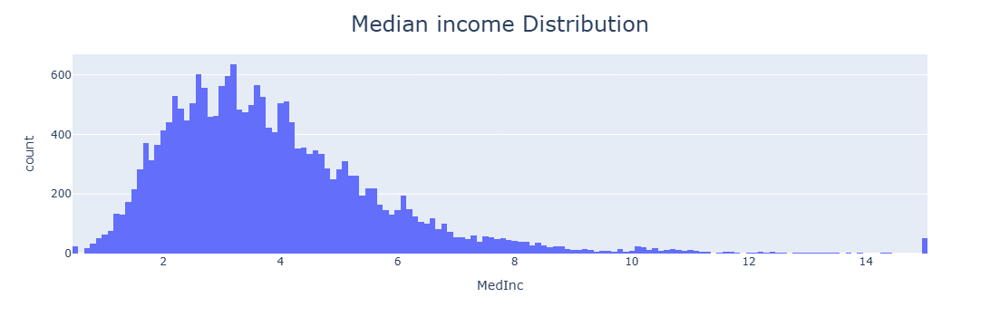

In [22]:
histogram(data , x = "MedInc", title="Median income Distribution")

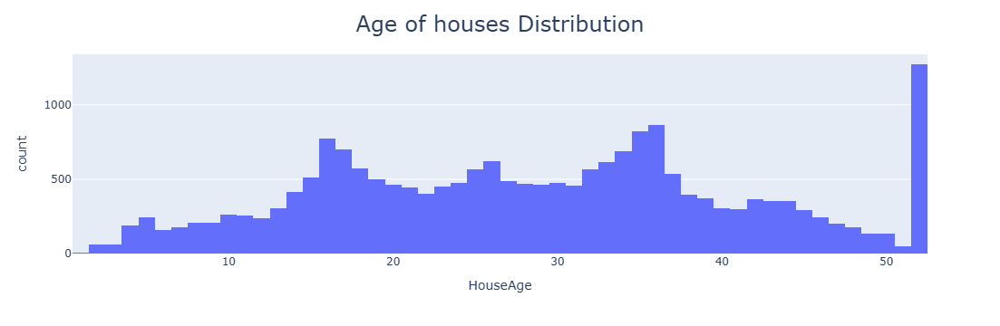

In [23]:
histogram(data , x = "HouseAge", title="Age of houses Distribution")

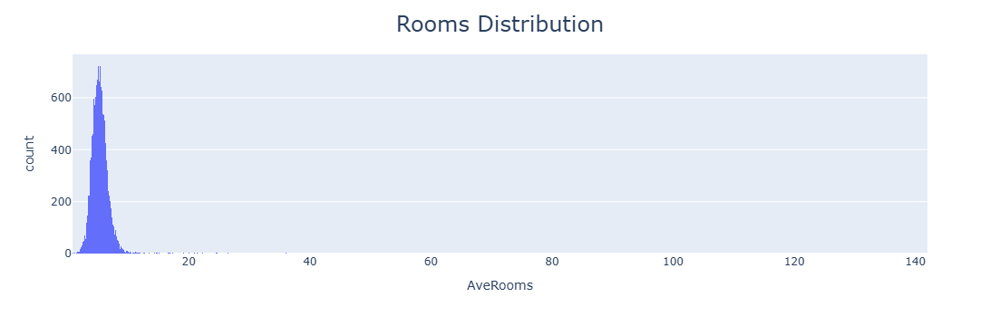

In [24]:
histogram(data , x = "AveRooms", title="Rooms Distribution")

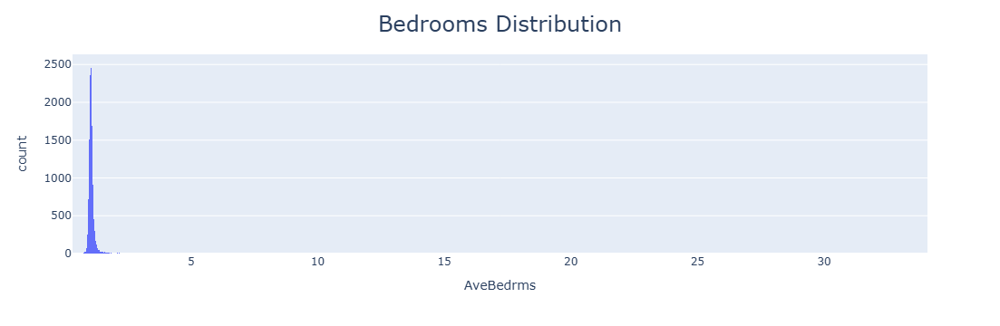

In [25]:
histogram(data , x = "AveBedrms", title="Bedrooms Distribution")

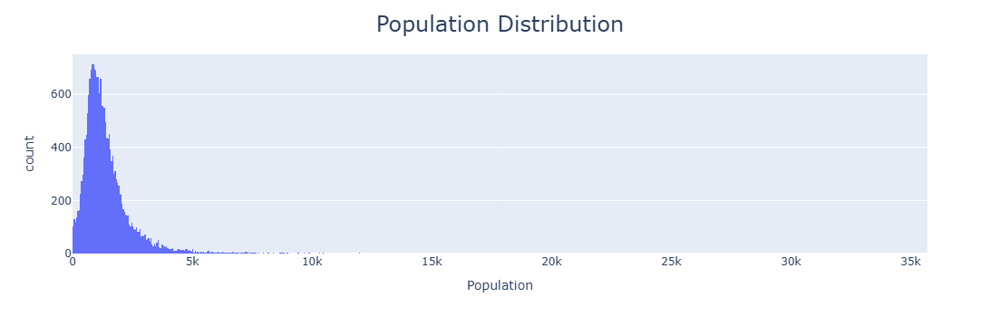

In [26]:
histogram(data , x = "Population", title="Population Distribution")

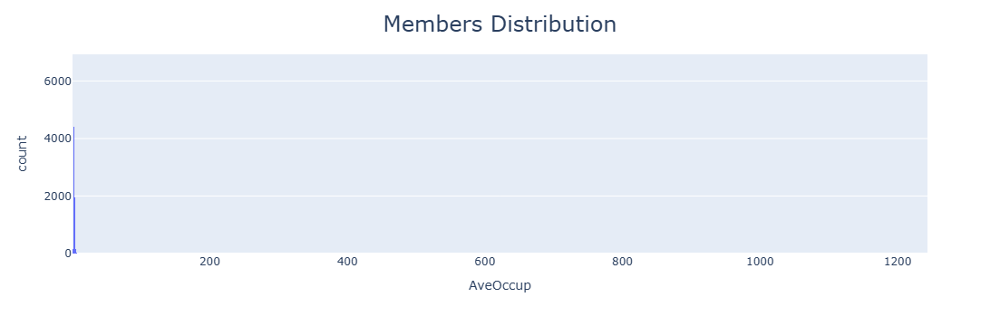

In [27]:
histogram(data , x = "AveOccup", title="Members Distribution")

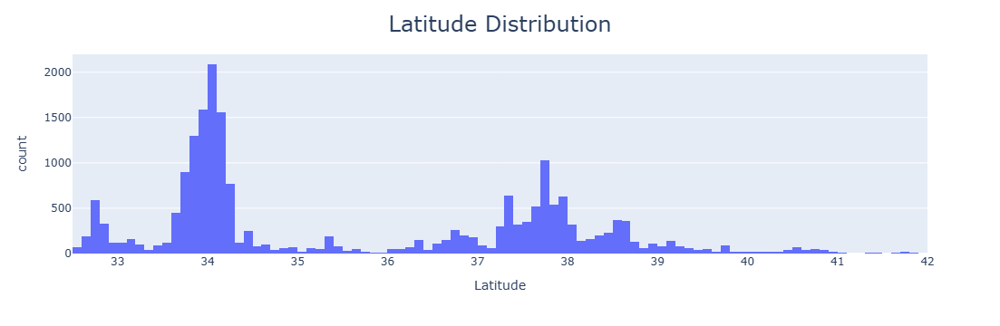

In [28]:
histogram(data , x = "Latitude", title="Latitude Distribution")

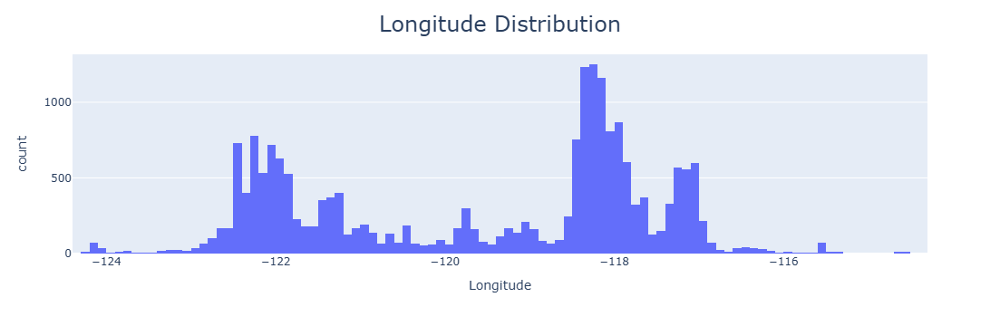

In [29]:
histogram(data , x = "Longitude", title="Longitude Distribution")

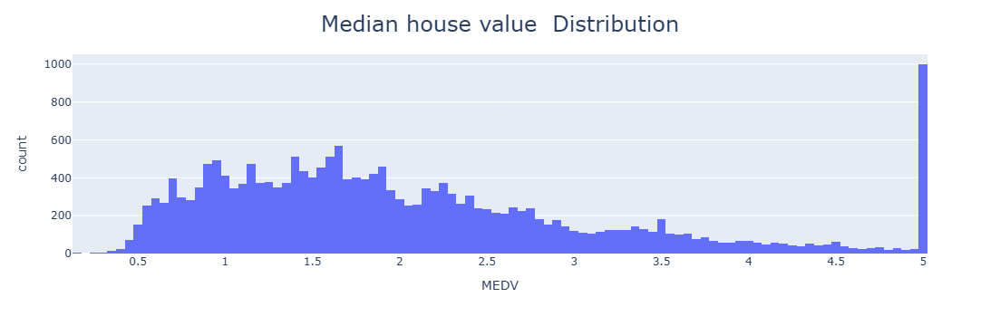

In [30]:
histogram(data , x = "MEDV", title=" Median house value  Distribution")


we observe the following distribution characteristics:
- The distributions of MedInc , HouseAge , Latitude , Longitude and MEDV appear to be approximately **normal**.
-  AveRooms , AveBedrms , Population and AveOccup are **skewed to the left**. 

In [51]:
# Function to draw boxplot
def draw_box_plots(data):

    numerical_cols = data.select_dtypes(include=['number']).columns
    
    for column in numerical_cols:
        fig = go.Figure()
        fig.add_trace(go.Box(y=data[column], name=column))
        fig.update_layout(title=f'Box Plot for {column}', yaxis=dict(title=column))
        fig.show()

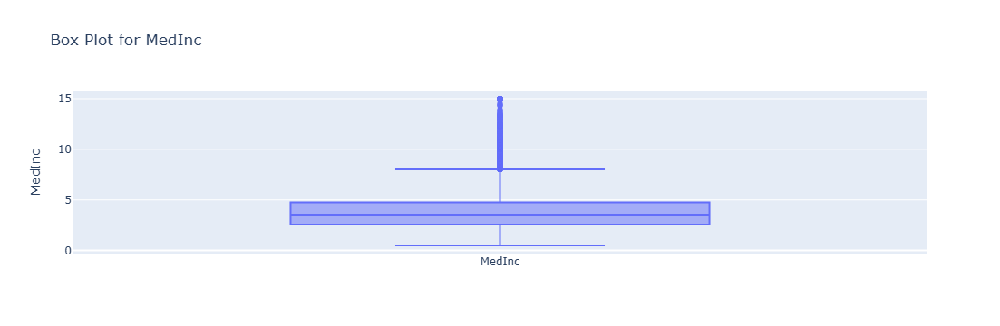

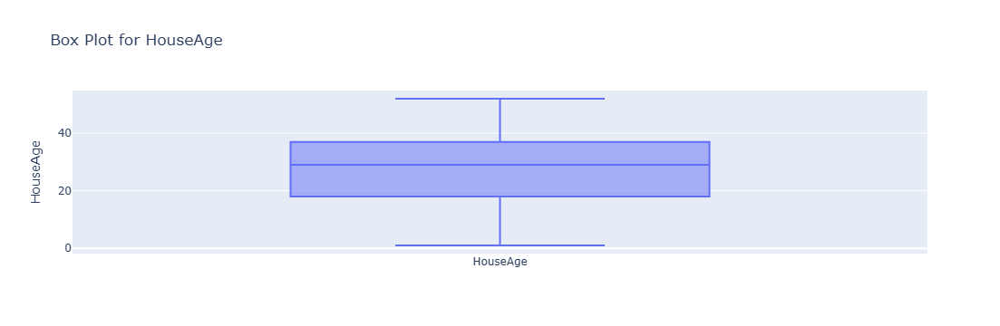

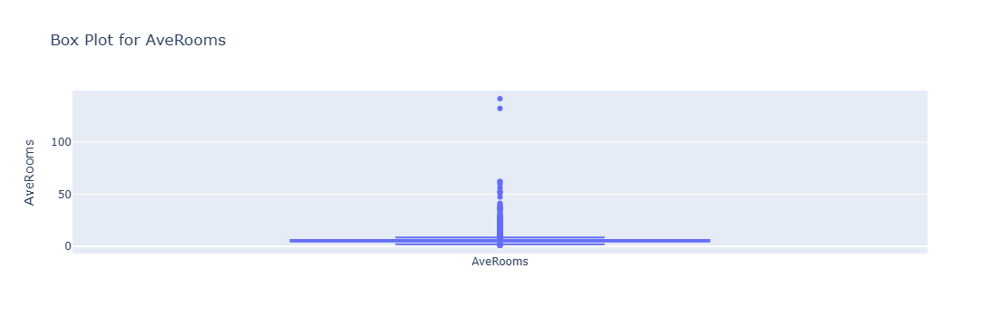

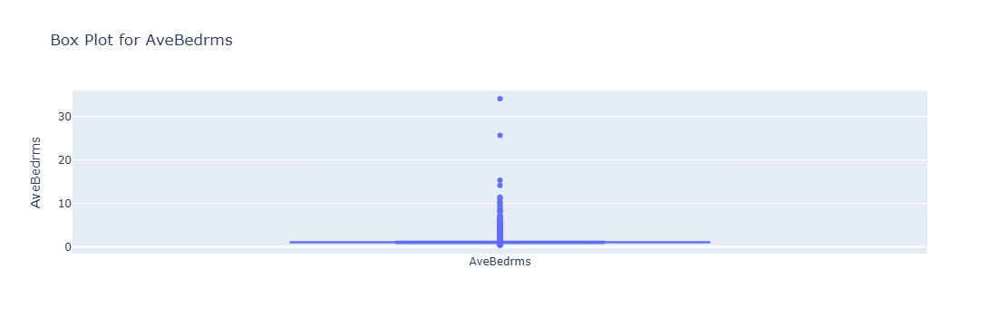

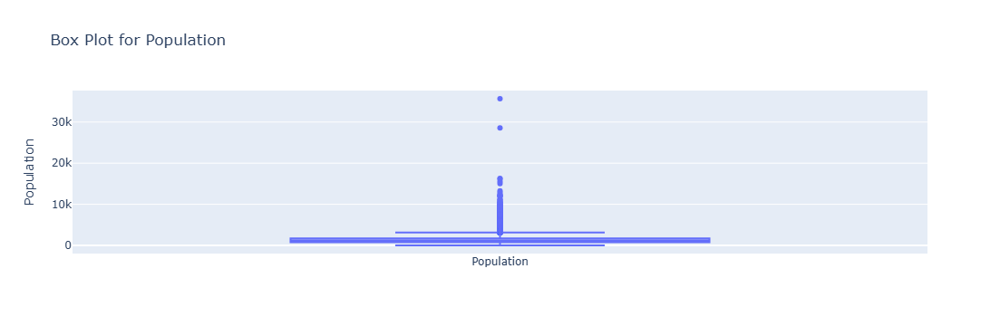

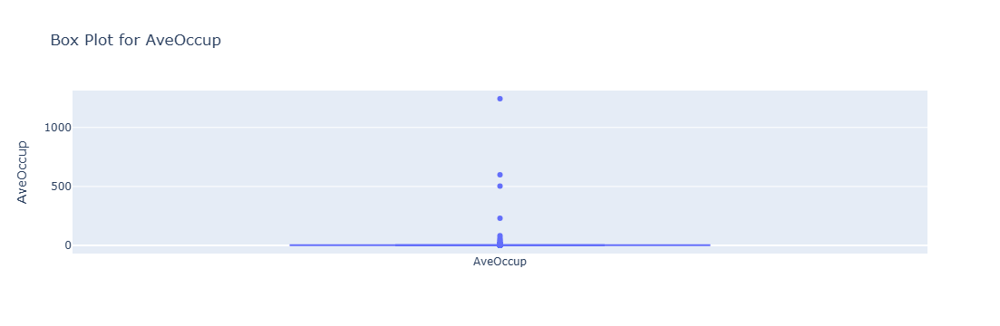

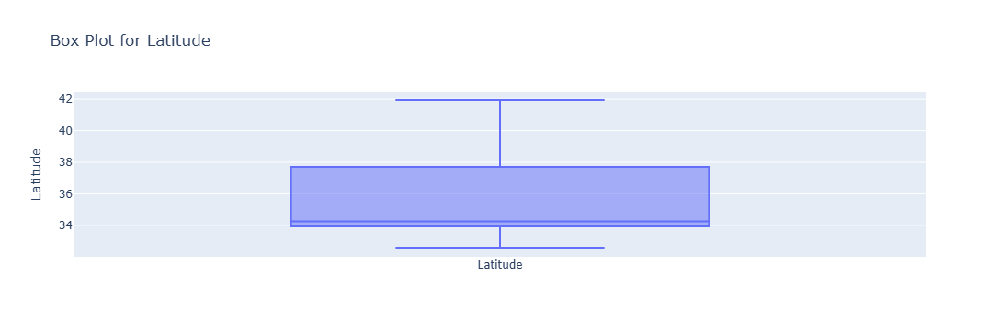

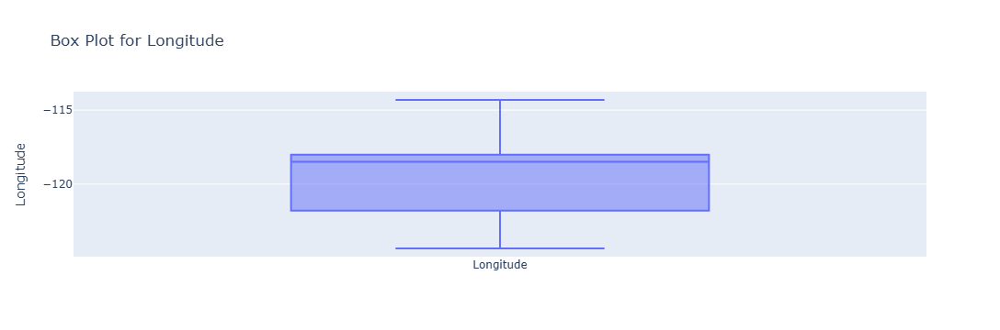

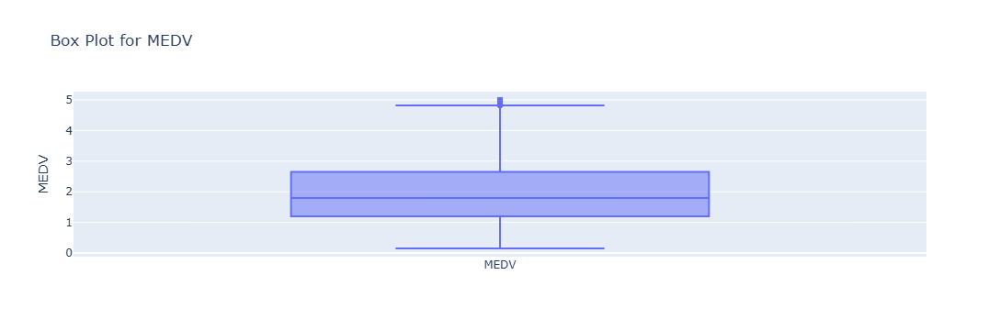

In [52]:
draw_box_plots(data)

we observe the following  characteristics:

- MedInc , AveRooms , AveBedrms , Population , AveOccup and MEDV have **outliers**.
- Latitude and Longitude   have **no outliers**.

### Bivariate Analysis

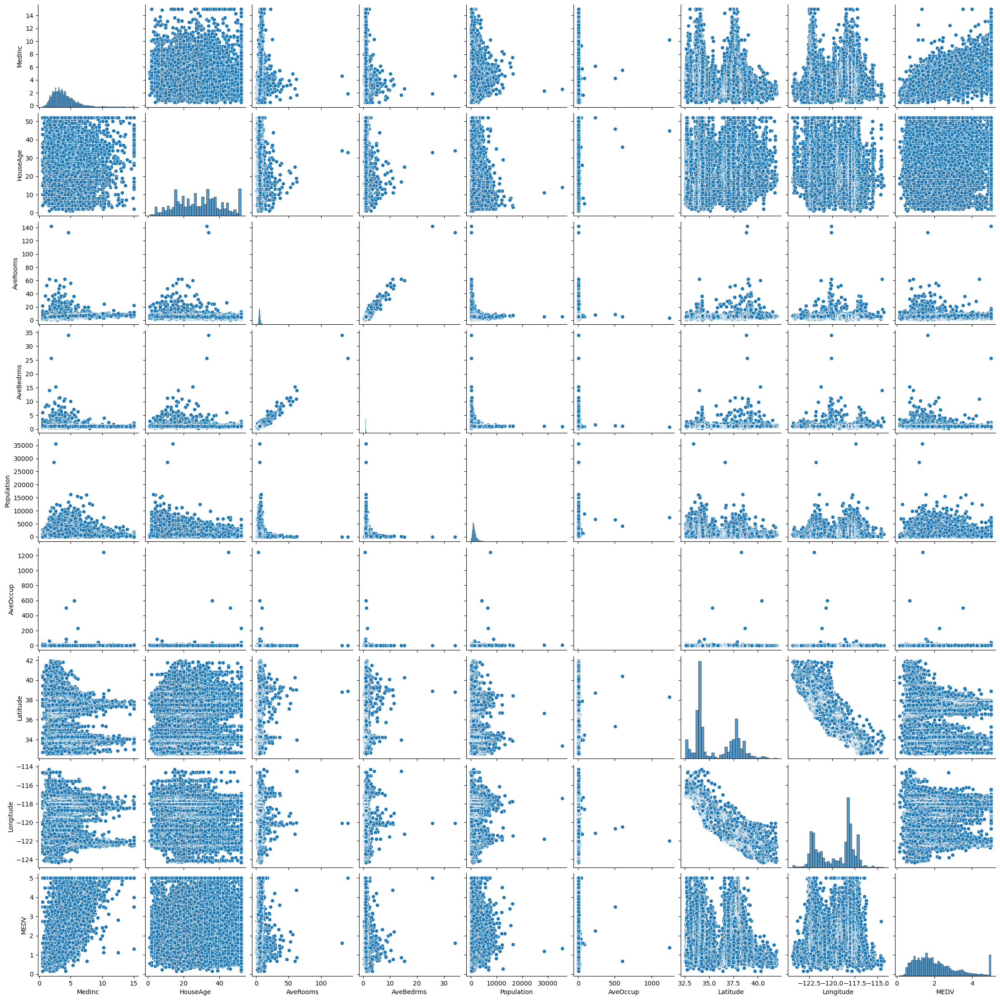

In [34]:
sns.pairplot(data)

### Data Cleaning

In [55]:
def remove_outliers(df, columns):

    df_clean = df.copy()
    
    for col in columns:
        Q1 = df_clean[col].quantile(0.25)
        Q3 = df_clean[col].quantile(0.75)
        IQR = Q3 - Q1
        
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR
        
        df_clean = df_clean[(df_clean[col] >= lower_bound) & (df_clean[col] <= upper_bound)]
        
    return df_clean

In [56]:
cleaned_data = remove_outliers(data, ['MedInc', 'AveRooms' , 'AveBedrms' , 'Population' , 'AveOccup' , 'MEDV'])

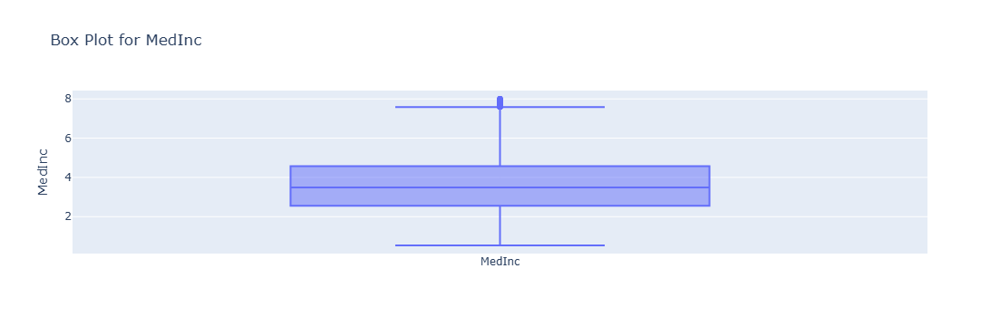

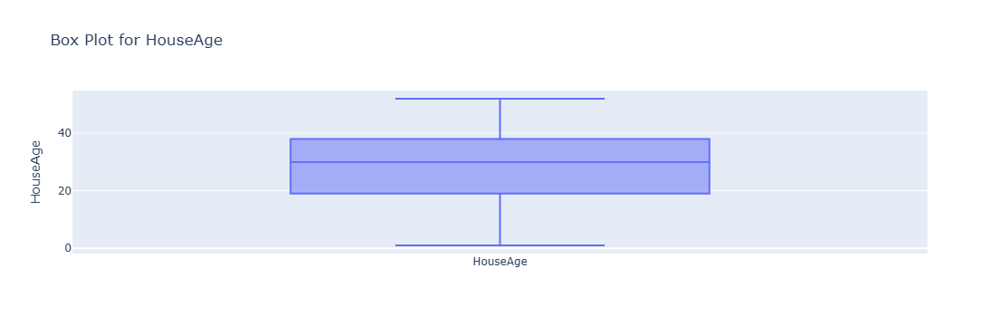

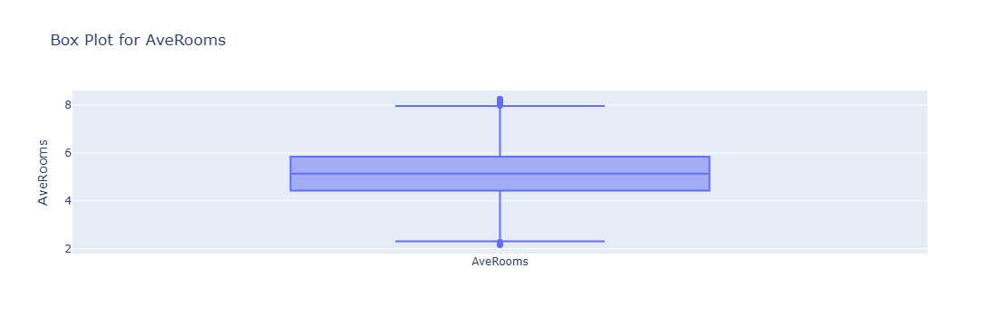

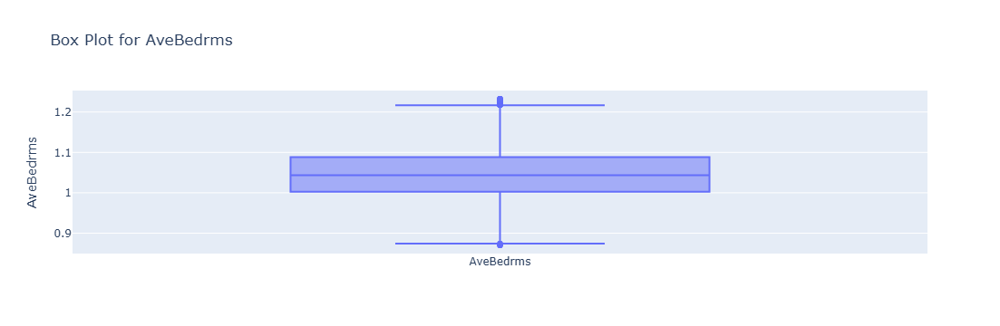

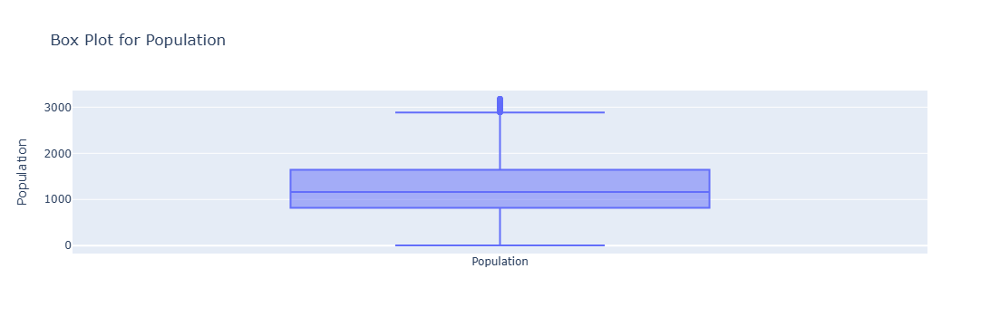

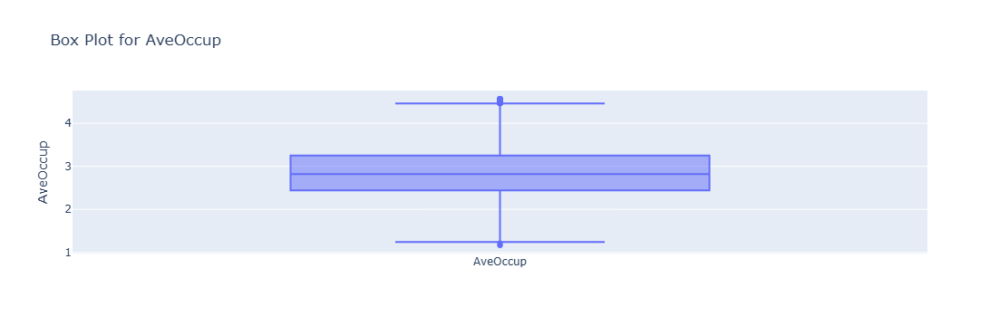

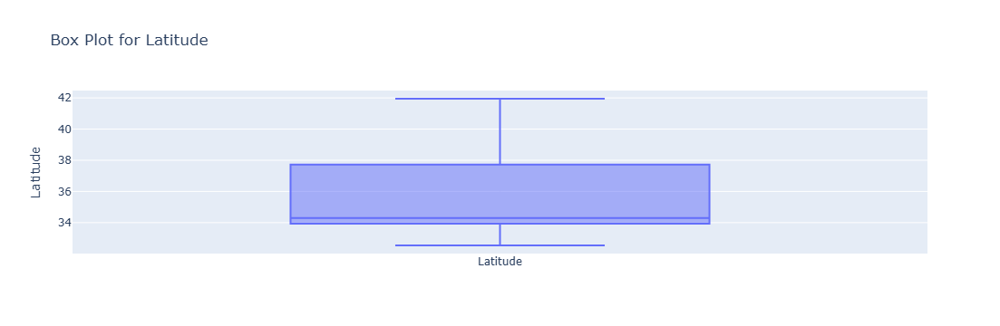

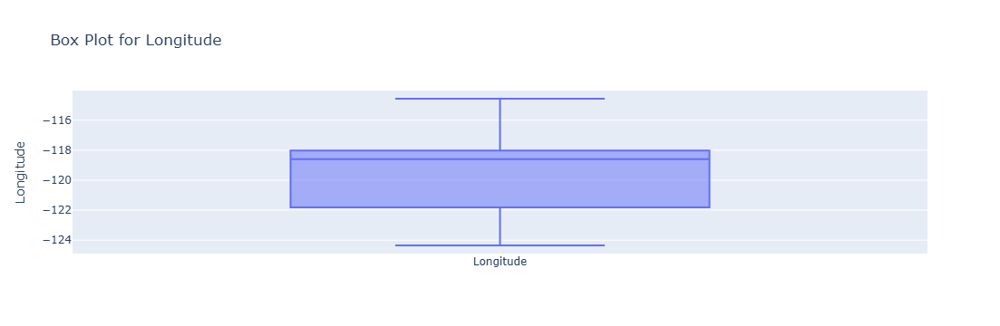

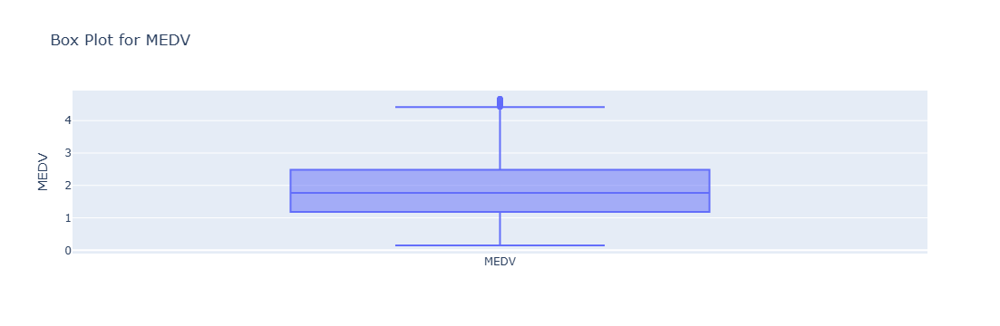

In [57]:
draw_box_plots(cleaned_data)

### Feature Selection

In [58]:
correlation_matrix = cleaned_data.corr()
correlation_matrix

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,MEDV
MedInc,1.000000,-0.182531,0.697929,-0.259993,-0.002915,-0.032088,-0.075565,-0.012836,0.630706
HouseAge,-0.182531,1.000000,-0.208716,-0.070692,-0.275479,-0.002030,0.004134,-0.088029,0.085420
AveRooms,0.697929,-0.208716,1.000000,-0.005936,-0.069509,0.054337,0.136080,-0.095824,0.256783
AveBedrms,-0.259993,-0.070692,-0.005936,1.000000,0.085638,-0.086528,0.034884,-0.003888,-0.099329
Population,-0.002915,-0.275479,-0.069509,0.085638,1.000000,0.207743,-0.112683,0.105164,-0.004531
AveOccup,-0.032088,-0.002030,0.054337,-0.086528,0.207743,1.000000,-0.167440,0.186777,-0.274968
Latitude,-0.075565,0.004134,0.136080,0.034884,-0.112683,-0.167440,1.000000,-0.933307,-0.149929
Longitude,-0.012836,-0.088029,-0.095824,-0.003888,0.105164,0.186777,-0.933307,1.000000,-0.044591
MEDV,0.630706,0.085420,0.256783,-0.099329,-0.004531,-0.274968,-0.149929,-0.044591,1.000000


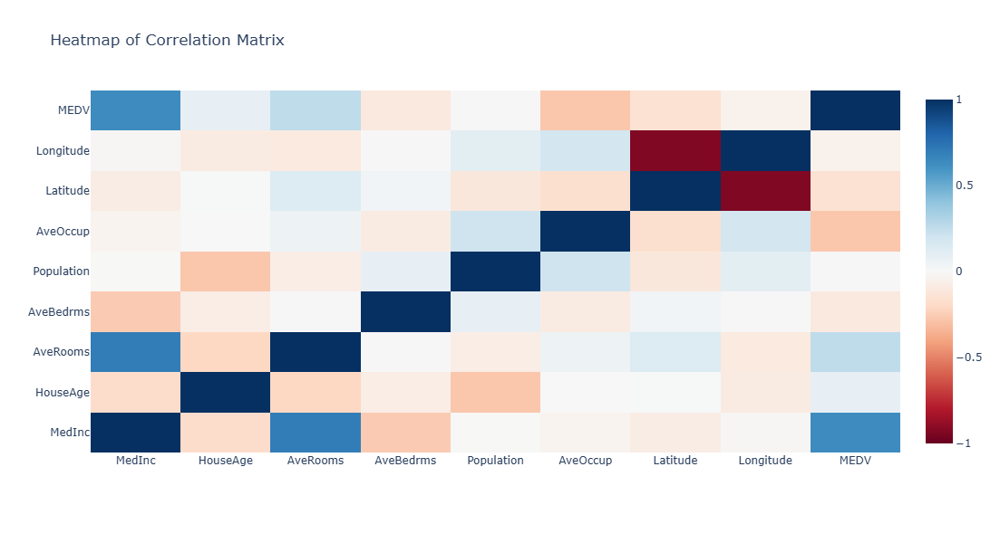

In [60]:
fig = go.Figure(data=go.Heatmap(
    z=correlation_matrix.values,
    x=correlation_matrix.columns,
    y=correlation_matrix.columns,
    colorscale='RdBu',
    zmin=-1, zmax=1
))

fig.update_layout(
    title='Heatmap of Correlation Matrix',
    xaxis_nticks=36,
    width=600,
    height=600,
    margin=dict(l=100, r=100, t=100, b=100)
)

fig.show()

In [61]:
x = cleaned_data.drop('MEDV', axis=1)
x

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25
5,4.0368,52.0,4.761658,1.103627,413.0,2.139896,37.85,-122.25
6,3.6591,52.0,4.931907,0.951362,1094.0,2.128405,37.84,-122.25
7,3.1200,52.0,4.797527,1.061824,1157.0,1.788253,37.84,-122.25
...,...,...,...,...,...,...,...,...
20634,3.7125,28.0,6.779070,1.148256,1041.0,3.026163,39.27,-121.56
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32


In [62]:
y = cleaned_data['MEDV']
y

3        3.413
4        3.422
5        2.697
6        2.992
7        2.414
         ...  
20634    1.168
20635    0.781
20637    0.923
20638    0.847
20639    0.894
Name: MEDV, Length: 16232, dtype: float64

In [63]:
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.3, random_state=42)

In [64]:
print(f'The shape of X train{x_train.shape}')
print(f'The shape of Y train{y_train.shape}')
print(f'The shape of X test{x_test.shape}')
print(f'The shape of Y test{y_test.shape}')

The shape of X train(11362, 8)
The shape of Y train(11362,)
The shape of X test(4870, 8)
The shape of Y test(4870,)


In [76]:
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_test = scaler.transform(x_test)

### Model Training and Evaluation

In [77]:
model = LinearRegression()
model.fit(x_train, y_train)

LinearRegression()

In [78]:
y_pred_train = model.predict(x_train)

In [79]:
# Calculate evaluation metrics for the training set
mae_train = mean_absolute_error(y_train, y_pred_train)
mse_train = mean_squared_error(y_train, y_pred_train)
rmse_train = np.sqrt(mse_train)
r2_train = r2_score(y_train, y_pred_train)

In [80]:
print(f'Training Set Evaluation Metrics:')
print(f'MAE: {mae_train}')
print(f'MSE: {mse_train}')
print(f'RMSE: {rmse_train}')
print(f'R-squared: {r2_train}')

Training Set Evaluation Metrics:
MAE: 0.4211845618334527
MSE: 0.30611128993437214
RMSE: 0.553273250694783
R-squared: 0.647629280093537


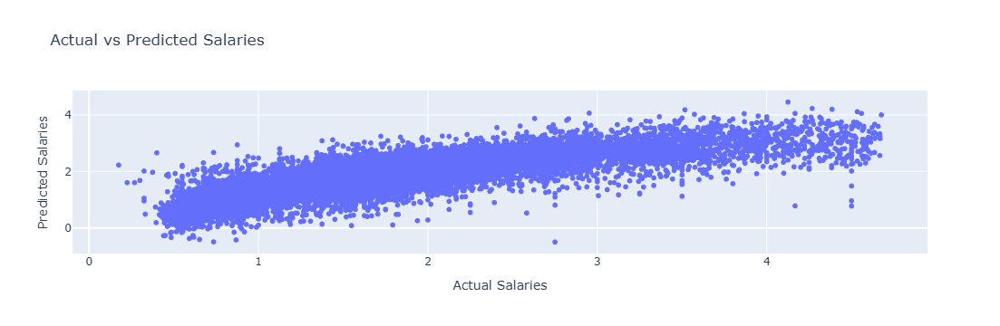

In [81]:
fig = px.scatter(x=y_train, y=y_pred_train, labels={'x': 'Actual Salaries', 'y': 'Predicted Salaries'}, title='Actual vs Predicted Salaries')
fig.show()

In [82]:
y_pred_test = model.predict(x_test)

In [83]:
mae_test = mean_absolute_error(y_test, y_pred_test)
mse_test = mean_squared_error(y_test, y_pred_test)
rmse_test = np.sqrt(mse_test)
r2_test = r2_score(y_test, y_pred_test)

In [84]:
print(f'\nTesting Set Evaluation Metrics:')
print(f'MAE: {mae_test}')
print(f'MSE: {mse_test}')
print(f'RMSE: {rmse_test}')
print(f'R-squared: {r2_test}')


Testing Set Evaluation Metrics:
MAE: 0.4299699641816599
MSE: 0.3279048033200755
RMSE: 0.5726297261931793
R-squared: 0.6170639423370832


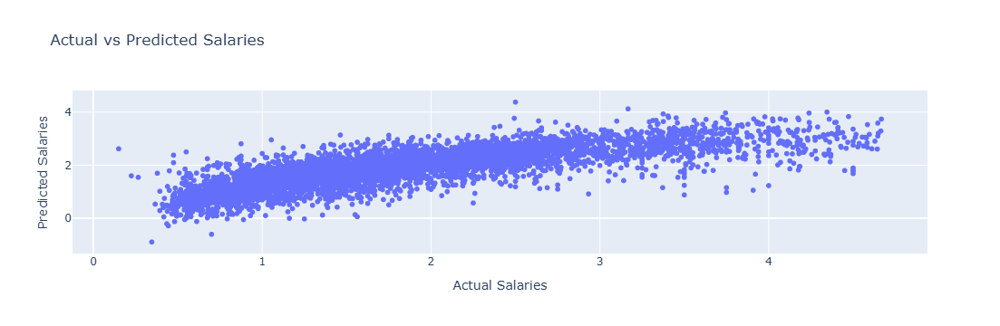

In [85]:
fig = px.scatter(x=y_test, y=y_pred_test, labels={'x': 'Actual Salaries', 'y': 'Predicted Salaries'}, title='Actual vs Predicted Salaries')
fig.show()